In [1]:
import glob
import numpy as np
import pandas as pd
from pprint import pprint

import matplotlib.pyplot as plt

import segysak.segy as sg

/appdrive/mambaforge/envs/py37_tensorflow/lib/python3.7/site-packages/segysak/segy/_segy_core.py:7: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm


In [2]:
file = r"/mnt/02 Penobscot/3D_gathers_pstm_nmo_*.sgy"
seis = sorted(glob.glob(file))
index = 2
print(seis)

['/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1041.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1081.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1121.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1161.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1201.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1241.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1281.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1321.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1361.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1401.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1441.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1481.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1521.sgy', '/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1561.sgy']


In [5]:
# Load Seg-y header
scan = sg.segy_header_scan(seis[index])
scan.head(20)

  0%|          | 0.00/1.00k [00:00<?, ? traces/s]

,byte_loc,count,mean,std,min,25%,50%,75%,max
TRACE_SEQUENCE_LINE,1,1000.0,500.500,288.819436,1.0,250.75,500.5,750.25,1000.0
TRACE_SEQUENCE_FILE,5,1000.0,1121.000,0.000000,1121.0,1121.00,1121.0,1121.00,1121.0
FieldRecord,9,1000.0,1008.653,4.740576,1000.0,1005.00,1009.0,1013.00,1017.0
TraceNumber,13,1000.0,1121.000,0.000000,1121.0,1121.00,1121.0,1121.00,1121.0
EnergySourcePoint,17,1000.0,1008.653,4.740576,1000.0,1005.00,1009.0,1013.00,1017.0
CDP,21,1000.0,1121.000,0.000000,1121.0,1121.00,1121.0,1121.00,1121.0
CDP_TRACE,25,1000.0,1008.653,4.740576,1000.0,1005.00,1009.0,1013.00,1017.0
TraceIdentificationCode,29,1000.0,1.000,0.000000,1.0,1.00,1.0,1.00,1.0
NSummedTraces,31,1000.0,121.498,70.776389,2.0,60.00,124.0,184.00,240.0
NStackedTraces,33,1000.0,2.000,0.000000,2.0,2.00,2.0,2.00,2.0


In [41]:
scrape = sg.segy_header_scrape(seis[index], partial_scan = 1000)
scrape.columns        

  0%|          | 0.00/1.00k [00:00<?, ? traces/s]

Index(['TRACE_SEQUENCE_LINE', 'TRACE_SEQUENCE_FILE', 'FieldRecord',
       'TraceNumber', 'EnergySourcePoint', 'CDP', 'CDP_TRACE',
       'TraceIdentificationCode', 'NSummedTraces', 'NStackedTraces', 'DataUse',
       'offset', 'ReceiverGroupElevation', 'SourceSurfaceElevation',
       'SourceDepth', 'ReceiverDatumElevation', 'SourceDatumElevation',
       'SourceWaterDepth', 'GroupWaterDepth', 'ElevationScalar',
       'SourceGroupScalar', 'SourceX', 'SourceY', 'GroupX', 'GroupY',
       'CoordinateUnits', 'WeatheringVelocity', 'SubWeatheringVelocity',
       'SourceUpholeTime', 'GroupUpholeTime', 'SourceStaticCorrection',
       'GroupStaticCorrection', 'TotalStaticApplied', 'LagTimeA', 'LagTimeB',
       'DelayRecordingTime', 'MuteTimeStart', 'MuteTimeEND',
       'TRACE_SAMPLE_COUNT', 'TRACE_SAMPLE_INTERVAL', 'GainType',
       'InstrumentGainConstant', 'InstrumentInitialGain', 'Correlated',
       'SweepFrequencyStart', 'SweepFrequencyEnd', 'SweepLength', 'SweepType',
       'Swee

In [42]:
scrape.columns.get_loc("INLINE_3D")

73

In [6]:
scrape

,TRACE_SEQUENCE_LINE,TRACE_SEQUENCE_FILE,FieldRecord,TraceNumber,EnergySourcePoint,CDP,CDP_TRACE,TraceIdentificationCode,NSummedTraces,NStackedTraces,...,TransductionConstantPower,TransductionUnit,TraceIdentifier,ScalarTraceHeader,SourceType,SourceEnergyDirectionMantissa,SourceEnergyDirectionExponent,SourceMeasurementMantissa,SourceMeasurementExponent,SourceMeasurementUnit
0,1,1041,1000,1041,1000,1041,1000,1,140,2,...,16945,0,16945,0,0,0,0,0,17842,-23030
1,2,1041,1000,1041,1000,1041,1000,1,136,2,...,16945,0,16945,0,0,0,0,0,17842,-23030
2,3,1041,1000,1041,1000,1041,1000,1,132,2,...,16945,0,16945,0,0,0,0,0,17842,-23030
3,4,1041,1000,1041,1000,1041,1000,1,128,2,...,16945,0,16945,0,0,0,0,0,17842,-23030
4,5,1041,1000,1041,1000,1041,1000,1,124,2,...,16945,0,16945,0,0,0,0,0,17842,-23030
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
988222,988223,1080,1481,1080,1481,1080,1481,1,20,2,...,16945,0,16945,0,0,0,0,0,17845,12790
988223,988224,1080,1481,1080,1481,1080,1481,1,16,2,...,16945,0,16945,0,0,0,0,0,17845,12790
988224,988225,1080,1481,1080,1481,1080,1481,1,12,2,...,16945,0,16945,0,0,0,0,0,17845,12790
988225,988226,1080,1481,1080,1481,1080,1481,1,8,2,...,16945,0,16945,0,0,0,0,0,17845,12790


In [7]:
scrape[['INLINE_3D', 'CROSSLINE_3D']]

,INLINE_3D,CROSSLINE_3D
0,1179296348,1111064576
1,1179296370,1111064576
2,1179296392,1111064576
3,1179296415,1111064576
4,1179296437,1111064576
...,...,...
988222,1179302993,1111064576
988223,1179303015,1111064576
988224,1179303026,1111064576
988225,1179303048,1111064576


In [94]:
# Changing the header names to read the correct input, special thanks to Syadhisy
scrape['TRACE_SEQUENCE_FILE'] = scrape['TRACE_SEQUENCE_FILE'].astype(int)
scrape['FieldRecord'] = scrape['FieldRecord'].astype(int)
scrape['CDP_UPD'] = scrape['TRACE_SEQUENCE_FILE'] * 10000 + scrape['FieldRecord']
df = scrape[['TRACE_SEQUENCE_FILE', 'FieldRecord', 'offset', 'CDP_UPD']]
df = df.rename(columns = {"TRACE_SEQUENCE_FILE": "ILINE",
                                        "FieldRecord":"XLINE",
                                        "offset":"OFFSET",
                                        "CDP_UPD":"CDP"})
df

,ILINE,XLINE,OFFSET,CDP
0,1081,1001,175,10811001
1,1081,1001,225,10811001
2,1081,1001,275,10811001
3,1081,1001,325,10811001
4,1081,1001,375,10811001
...,...,...,...,...
995,1081,1017,1125,10811017
996,1081,1017,1175,10811017
997,1081,1017,1225,10811017
998,1081,1017,1275,10811017


In [95]:
seis[index]

'/mnt/02 Penobscot/3D_gathers_pstm_nmo_X1121.sgy'

In [96]:
# Reading data
data = sg.segy_loader(seis[index], iline=21, xline=9, cdpx=73, cdpy=77, offset=37)

  0%|          | 0.00/1.17M [00:00<?, ? traces/s]

Loading as 3D
Fast direction is CDP


Converting SEGY:   0%|          | 0.00/1.17M [00:00<?, ? traces/s]

In [97]:
data

<xarray.Dataset>
Dimensions:  (iline: 40, xline: 482, twt: 1501, offset: 61)
Coordinates:
  * iline    (iline) uint16 1121 1122 1123 1124 1125 ... 1157 1158 1159 1160
  * xline    (xline) uint16 1000 1001 1002 1003 1004 ... 1478 1479 1480 1481
  * twt      (twt) float64 0.0 4.0 8.0 12.0 ... 5.992e+03 5.996e+03 6e+03
  * offset   (offset) uint16 175 225 275 325 375 ... 2975 3025 3075 3125 3175
    cdp_x    (iline, xline, offset) float32 nan nan nan ... 7.417e+05 nan
    cdp_y    (iline, xline, offset) float32 nan nan nan ... 4.897e+06 nan
Data variables:
    data     (iline, xline, twt, offset) float32 0.0 0.0 0.0 0.0 ... 0.0 0.0 0.0
Attributes: (12/13)
    ns:                  None
    sample_rate:         4.0
    text:                C 1 PROCESSED FOR : OETR        AREA: NOVA SCOTIA   ...
    measurement_system:  m
    d3_domain:           None
    epsg:                None
    ...                  ...
    corner_points_xy:    None
    source_file:         3D_gathers_pstm_nmo_X1121.sgy
    srd:                 None
    datatype:            None
    percentiles:         [-6876.647613485375, -6116.982398994797, -1377.77708...
    coord_scalar:        1.0

In [46]:
data.offset.values

array([ 175,  225,  275,  325,  375,  425,  475,  525,  575,  625,  675,
        725,  775,  825,  875,  925,  975, 1025, 1075, 1125, 1175, 1225,
       1275, 1325, 1375, 1425, 1475, 1525, 1575, 1625, 1675, 1725, 1775,
       1825, 1875, 1925, 1975, 2025, 2075, 2125, 2175, 2225, 2275, 2325,
       2375, 2425, 2475, 2525, 2575, 2625, 2675, 2725, 2775, 2825, 2875,
       2925, 2975, 3025, 3075, 3125, 3175], dtype=uint16)

In [47]:
data.data.shape

(40, 482, 1501, 61)

In [98]:
reshaped_data = np.swapaxes(data.data.values, 2, -1)
reshaped_data[np.isnan(reshaped_data)] = 0
reshaped_data.shape

(40, 482, 61, 1501)

In [99]:
np.savez('/appdrive/Penobscot_i1121.npz', reshaped_data)

### Data Visualization

In [3]:
P_i1041 = np.load('/appdrive/Penobscot_i1041.npz')['arr_0']

In [50]:
P_i1081 = np.load('/appdrive/Penobscot_i1081.npz')['arr_0']

In [100]:
P_i1121 = np.load('/appdrive/Penobscot_i1121.npz')['arr_0']

In [107]:
# vmin = np.percentile(P_i1041, 10)
vmax = np.percentile(P_i1041, 97)

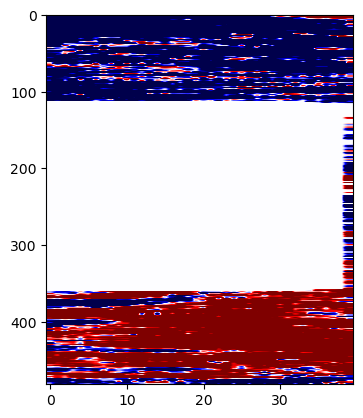

In [55]:
plt.imshow(P_i1041[:, :, 0, 100].T, aspect=0.1, cmap='seismic_r', vmin=-vmax, vmax=vmax)
plt.show()

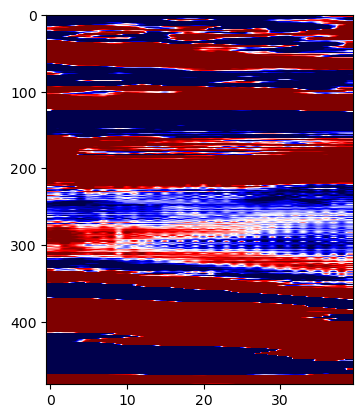

In [70]:
plt.imshow(P_i1081[:, :, 0, 50].T, aspect=0.1, cmap='seismic_r', vmin=-vmax, vmax=vmax)
plt.show()

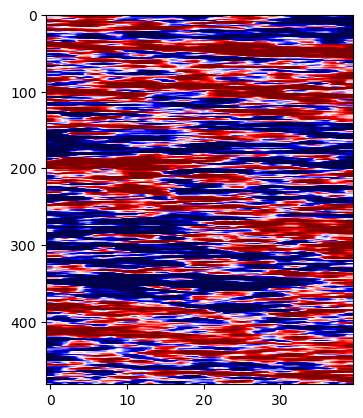

In [104]:
plt.imshow(P_i1121[:, :, 0, 300].T, aspect=0.1, cmap='seismic_r', vmin=-vmax, vmax=vmax)
plt.show()

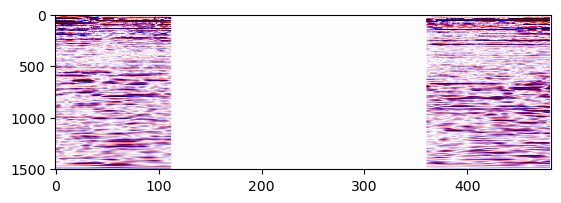

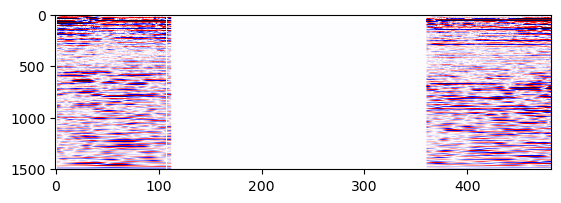

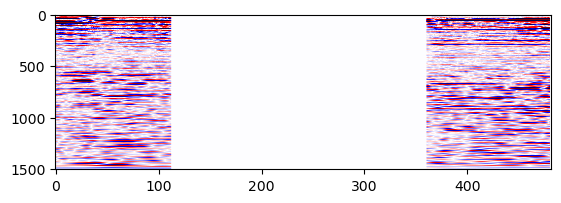

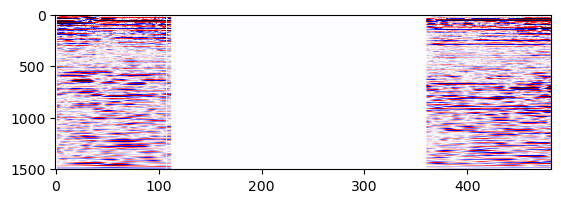

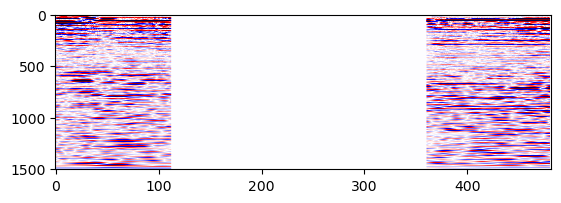

...

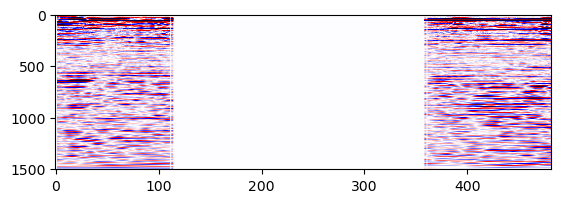

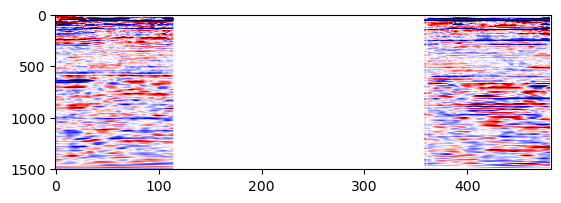

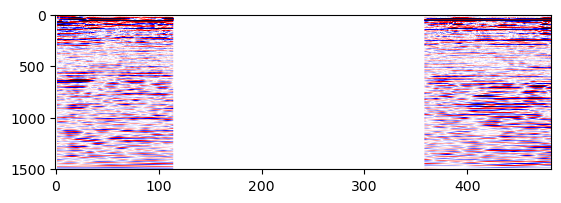

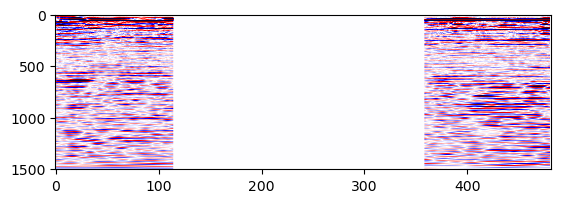

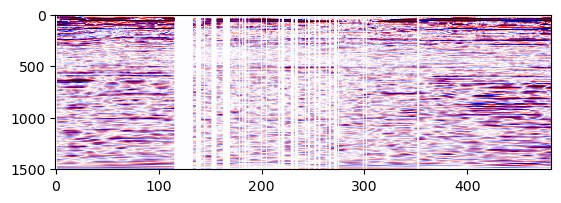

In [53]:
# IL1060, Offset 0
for i in range(d.shape[0]):
    plt.imshow(P_i1041[i, :, 0, :].T, aspect=0.1, cmap='seismic_r', vmin=-vmax, vmax=vmax)
    plt.show()

In [76]:
P_i1081[0, :, 0, 115:125]

array([[    0.     ,     0.     ,     0.     , ...,     0.     ,
            0.     ,     0.     ],
       [-3967.8733 , -2538.6965 , -1429.1533 , ..., -2033.5596 ,
         -547.937  ,  2972.0273 ],
       [-8596.602  , -7634.9688 , -3231.3816 , ..., -4959.8164 ,
        -2815.962  ,  5024.2656 ],
       ...,
       [ 3428.5002 ,  1956.2217 ,   469.34912, ...,  4057.8237 ,
         2443.4016 , -1427.1909 ],
       [ 3587.3752 ,  2437.1704 ,  -707.8032 , ..., -1318.5891 ,
        -2077.572  , -1150.2107 ],
       [    0.     ,     0.     ,     0.     , ...,     0.     ,
            0.     ,     0.     ]], dtype=float32)

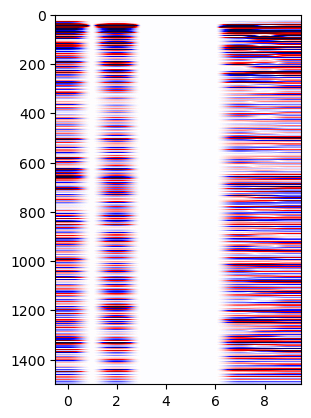

In [91]:
plt.imshow(P_i1081[0, 120:130, 0, :].T, aspect=0.01, cmap='seismic_r', vmin=-vmax, vmax=vmax)
plt.show()

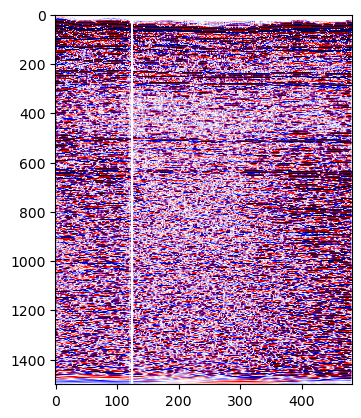

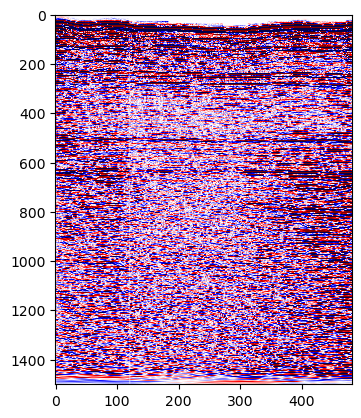

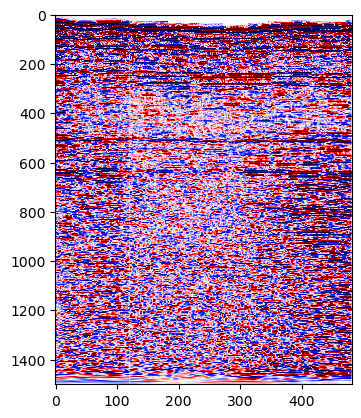

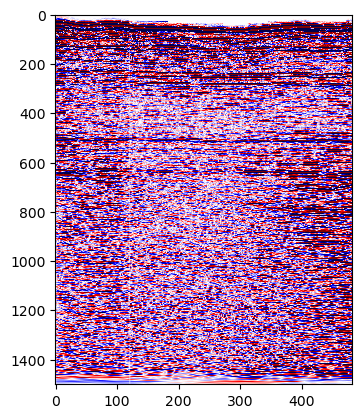

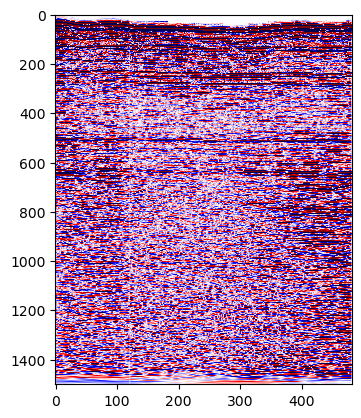

...

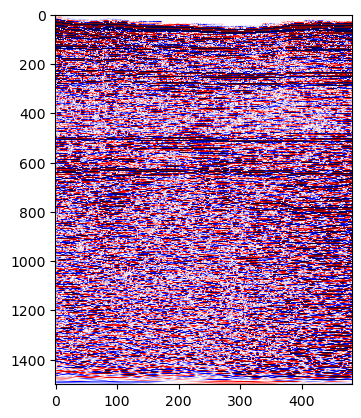

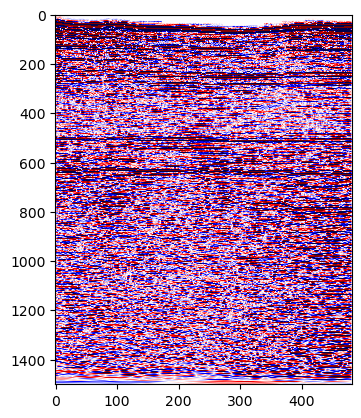

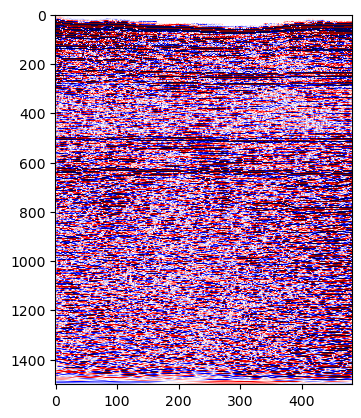

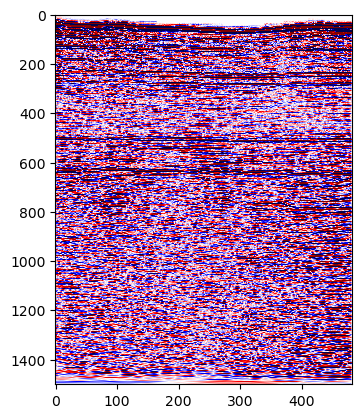

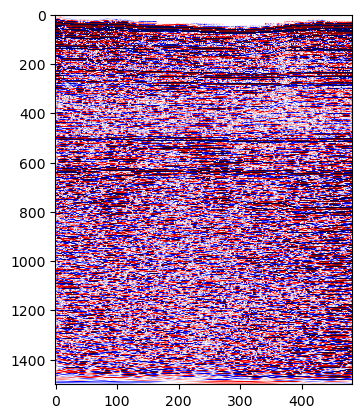

In [72]:
# IL1060, Offset 0
for i in range(d.shape[0]):
    plt.imshow(P_i1081[i, :, 0, :].T, aspect=0.4, cmap='seismic_r', vmin=-vmax, vmax=vmax)
    plt.show()

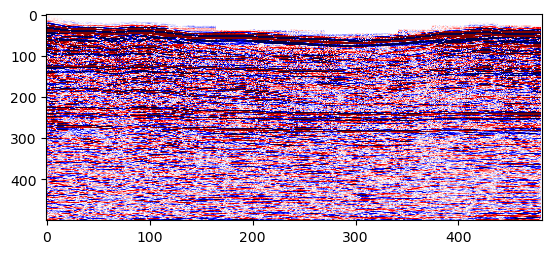

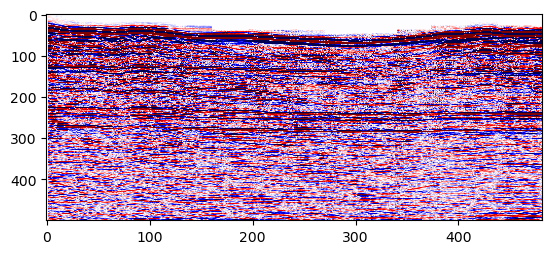

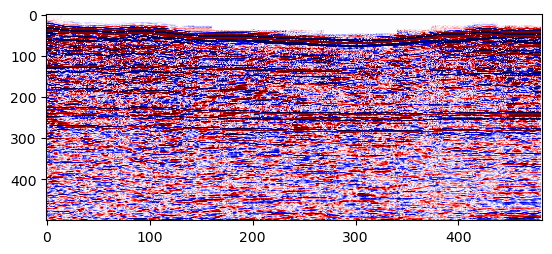

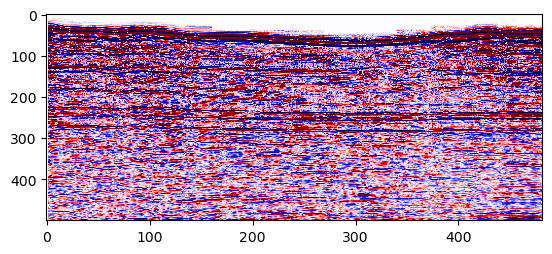

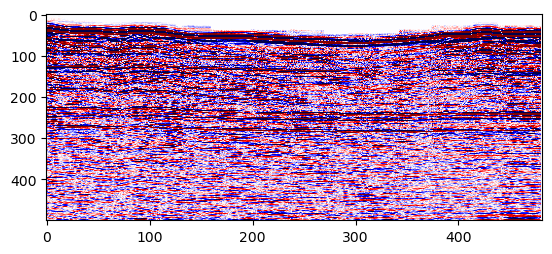

...

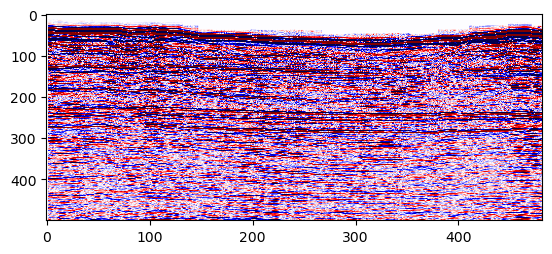

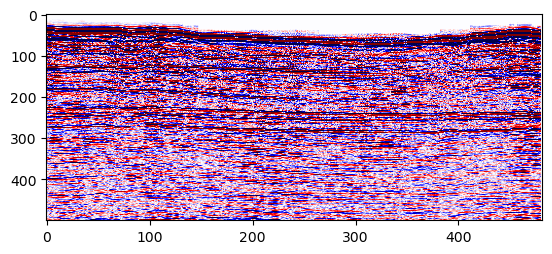

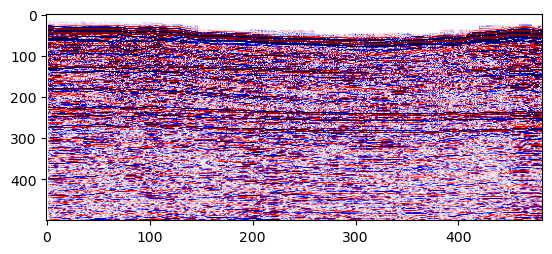

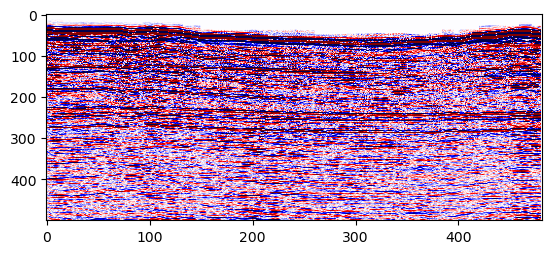

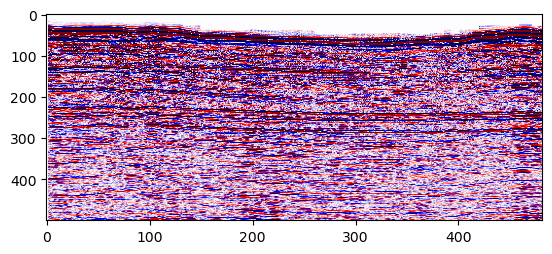

In [112]:
for i in range(d.shape[0]):
    plt.imshow(P_i1121[i, :, 0, :500].T, aspect=0.4, cmap='seismic_r', vmin=-vmax, vmax=vmax)
    plt.show()